In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import matplotlib.patches as mpatches

In [2]:
big_mart = pd.read_csv("BigMart_Sales_Data.csv")

In [3]:
big_mart

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
...,...,...,...,...,...,...,...,...,...,...,...,...
8518,FDF22,6.865,Low Fat,0.056783,Snack Foods,214.5218,OUT013,1987,High,Tier 3,Supermarket Type1,2778.3834
8519,FDS36,8.380,Regular,0.046982,Baking Goods,108.1570,OUT045,2002,NaN,Tier 2,Supermarket Type1,549.2850
8520,NCJ29,10.600,Low Fat,0.035186,Health and Hygiene,85.1224,OUT035,2004,Small,Tier 2,Supermarket Type1,1193.1136
8521,FDN46,7.210,Regular,0.145221,Snack Foods,103.1332,OUT018,2009,Medium,Tier 3,Supermarket Type2,1845.5976


In [4]:
big_mart.isnull().sum()

Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

## Check If The Item Weight Is Skewed Or Not So As To Figure Out Whether The Mean Or Median Is Suitable To Replace The Null Values

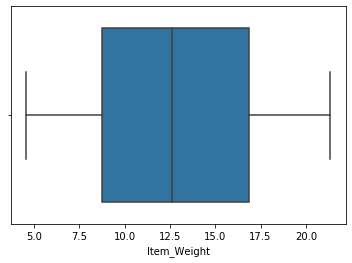

In [5]:
sns.boxplot(big_mart.Item_Weight)

# sns.distplot(big_mart['Item_Weight'])
# plt.axvline(x=np.mean(big_mart['Item_Weight']), c='red', ls='--', label='mean')
# plt.axvline(x=np.percentile(big_mart['Item_Weight'],25),c='green', ls='--', label = '25th percentile:Q1')
# plt.axvline(x=np.percentile(big_mart['Item_Weight'],75),c='orange', ls='--',label = '75th percentile:Q3' )
# plt.legend()

In [6]:
#Replace with the mean since the data is not skewed
item_type_mean = big_mart.groupby("Item_Type")["Item_Weight"].agg(["mean"]).reset_index()

In [7]:
item_type_mean

,Item_Type,mean
0,Baking Goods,12.277108
1,Breads,11.346936
2,Breakfast,12.768202
3,Canned,12.305705
4,Dairy,13.426069
5,Frozen Foods,12.867061
6,Fruits and Vegetables,13.224769
7,Hard Drinks,11.400328
8,Health and Hygiene,13.142314
9,Household,13.384736


In [8]:
pd.options.display.max_rows = None

In [9]:
big_mart

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
5,FDP36,10.395,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088
6,FDO10,13.650,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528
7,FDP10,NaN,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,NaN,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,NaN,Tier 2,Supermarket Type1,4710.5350


In [10]:
big_mart['Item_Weight'] = big_mart['Item_Weight'].fillna(big_mart['Item_Type'].map(item_type_mean.set_index('Item_Type')['mean']))

In [11]:
big_mart

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300000,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920000,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500000,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200000,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.930000,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
5,FDP36,10.395000,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088
6,FDO10,13.650000,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528
7,FDP10,12.987880,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200000,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,NaN,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200000,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,NaN,Tier 2,Supermarket Type1,4710.5350


## Replace The Missing Values Of The Outlet_Size Based On The Outlet Size Mode For A Particular Outlet Location Type

In [12]:
big_mart["Outlet_Size"] = big_mart["Outlet_Size"].fillna(big_mart.groupby("Outlet_Location_Type")["Outlet_Size"].transform(lambda s: pd.Series.mode(s).get(0)))

In [13]:
big_mart

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300000,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920000,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500000,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200000,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Medium,Tier 3,Grocery Store,732.3800
4,NCD19,8.930000,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
5,FDP36,10.395000,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088
6,FDO10,13.650000,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528
7,FDP10,12.987880,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200000,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,Small,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200000,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,Small,Tier 2,Supermarket Type1,4710.5350


In [14]:
big_mart.isnull().sum()

Item_Identifier              0
Item_Weight                  0
Item_Fat_Content             0
Item_Visibility              0
Item_Type                    0
Item_MRP                     0
Outlet_Identifier            0
Outlet_Establishment_Year    0
Outlet_Size                  0
Outlet_Location_Type         0
Outlet_Type                  0
Item_Outlet_Sales            0
dtype: int64

## Univariate Analysis

### a. Look at the distribution of the Item Weight

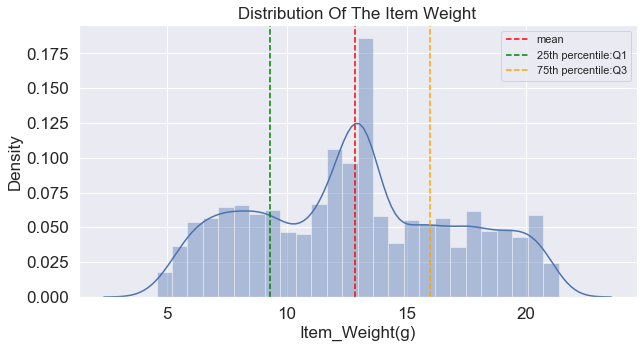

In [15]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.distplot(big_mart['Item_Weight'])
plt.title('Distribution Of The Item Weight', fontsize=17)
plt.axvline(x=np.mean(big_mart['Item_Weight']), c='red', ls='--', label='mean')
plt.axvline(x=np.percentile(big_mart['Item_Weight'],25),c='green', ls='--', label = '25th percentile:Q1')
plt.axvline(x=np.percentile(big_mart['Item_Weight'],75),c='orange', ls='--',label = '75th percentile:Q3' )
plt.xlabel('Item_Weight(g)', fontsize=17)
plt.ylabel('Density', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17)
plt.legend()
plt.show()

### The Item Weight is normally distributed. The mean weight of an item is ~13g.

### b. Look at the distribution of the Item Visibility

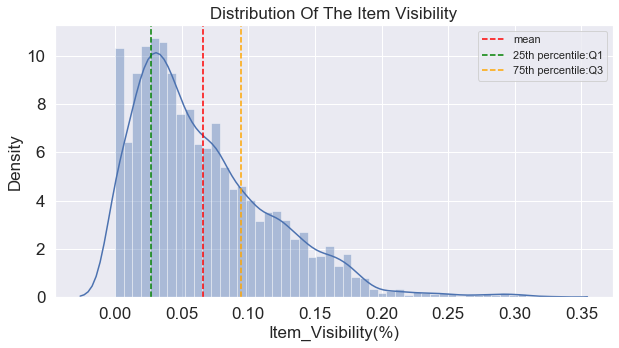

In [16]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.distplot(big_mart['Item_Visibility'])
plt.title('Distribution Of The Item Visibility', fontsize=17)
plt.axvline(x=np.mean(big_mart['Item_Visibility']), c='red', ls='--', label='mean')
plt.axvline(x=np.percentile(big_mart['Item_Visibility'],25),c='green', ls='--', label = '25th percentile:Q1')
plt.axvline(x=np.percentile(big_mart['Item_Visibility'],75),c='orange', ls='--',label = '75th percentile:Q3' )
plt.xlabel('Item_Visibility(%)', fontsize=17)
plt.ylabel('Density', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17)
plt.legend()
plt.show()

### The Item Visibility is skewed to the right. Most items have a visibility percentage ranging from 0.00% to 0.20%. A few have a visibility percentage ranging from 0.21% to 0.25%. The mean visibility is ~0.06%. Items that have a visibility of 0.26% and upwards are the ones that make the data have a shape that is skewed to the right.

### c. Visualize the distribution of the Item MRP

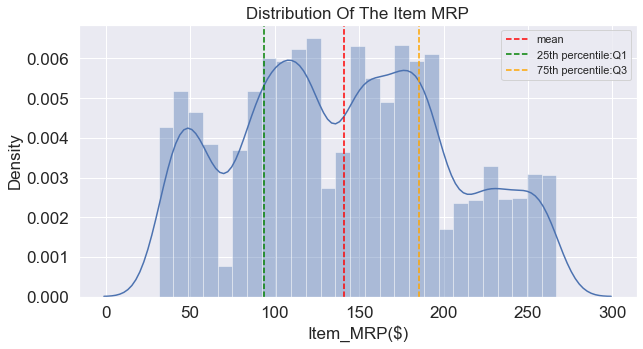

In [17]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.distplot(big_mart['Item_MRP'])
plt.title('Distribution Of The Item MRP', fontsize=17)
plt.axvline(x=np.mean(big_mart['Item_MRP']), c='red', ls='--', label='mean')
plt.axvline(x=np.percentile(big_mart['Item_MRP'],25),c='green', ls='--', label = '25th percentile:Q1')
plt.axvline(x=np.percentile(big_mart['Item_MRP'],75),c='orange', ls='--',label = '75th percentile:Q3' )
plt.xlabel('Item_MRP($)', fontsize=17)
plt.ylabel('Density', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.legend()
plt.show()

### Here normality is assumed. The mean MRP of an item is approximately $148.

### d. Visualize the distribution of the Item Outlet Sales

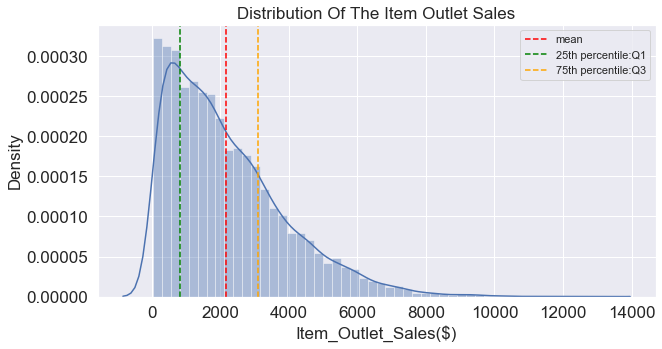

In [18]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.distplot(big_mart['Item_Outlet_Sales'])
plt.title('Distribution Of The Item Outlet Sales', fontsize=17)
plt.axvline(x=np.mean(big_mart['Item_Outlet_Sales']), c='red', ls='--', label='mean')
plt.axvline(x=np.percentile(big_mart['Item_Outlet_Sales'],25),c='green', ls='--', label = '25th percentile:Q1')
plt.axvline(x=np.percentile(big_mart['Item_Outlet_Sales'],75),c='orange', ls='--',label = '75th percentile:Q3' )
plt.xlabel('Item_Outlet_Sales($)', fontsize=17)
plt.ylabel('Density', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.legend()
plt.show()

### The graph is skewed to the right. Most outlets have sales that range from \\$1 to \\$6000. Very few outlets have sales that range from \\$6001 to \\$8000. Outlets that have sales above \\$8000 are the ones which make the data have a shape that is skewed to the right. 

### e. Check the fat content that is most popular among items

In [19]:
fat_replacements = {'low fat':'Low Fat', 'LF':'Low Fat', 'reg':'Regular'}
big_mart['Item_Fat_Content'] = big_mart['Item_Fat_Content'].map(fat_replacements, na_action='ignore')

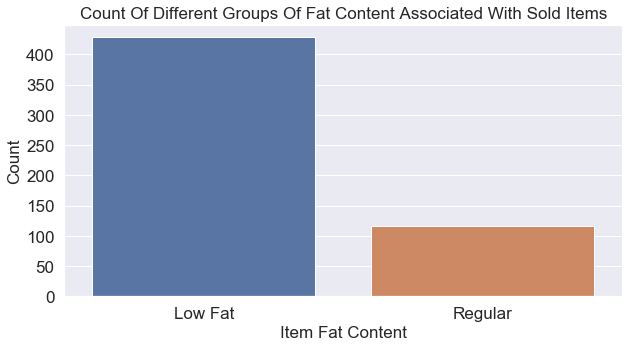

In [20]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.countplot(big_mart['Item_Fat_Content'])
plt.title('Count Of Different Groups Of Fat Content Associated With Sold Items', fontsize=17)
plt.xlabel('Item Fat Content', fontsize=17)
plt.ylabel('Count', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.show()

### Low fat content is more popular among the items sold as it has over 400 items compared to regular fat content which just has over 100 items.

### f. Check the item type that is most popular

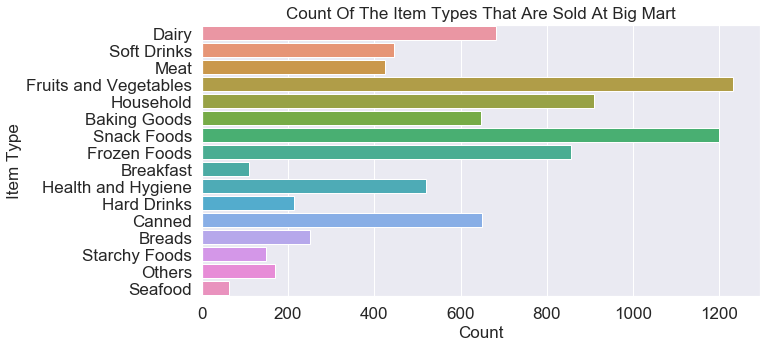

In [21]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.countplot(data=big_mart, y='Item_Type')
plt.title('Count Of The Item Types That Are Sold At Big Mart', fontsize=17)
plt.xlabel('Count', fontsize=17)
plt.ylabel('Item Type', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.show()

### Fruits and Vegetables are more popular as they have of 1200 in stock compared to the least popular item, sea food which has approximately less than 50 in stock.

### g. Check the outlet size that is most popular

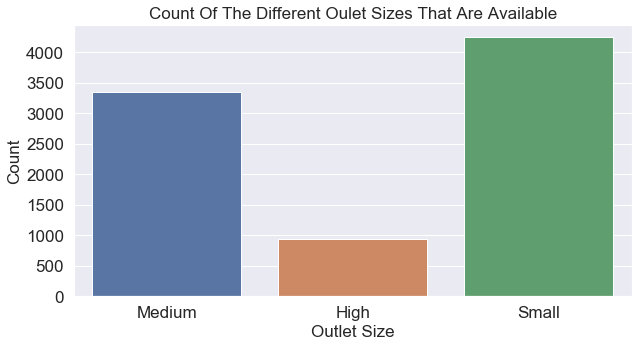

In [22]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.countplot(big_mart['Outlet_Size'])
plt.title('Count Of The Different Oulet Sizes That Are Available', fontsize=17)
plt.xlabel('Outlet Size', fontsize=17)
plt.ylabel('Count', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.show()

### Small outlet sizes are more popular with over 4000 of them, while high outlet sizes are least popular with just under a 1000.

## Bi-variate Analysis

### a. Check the relationship between item_visibility and item type

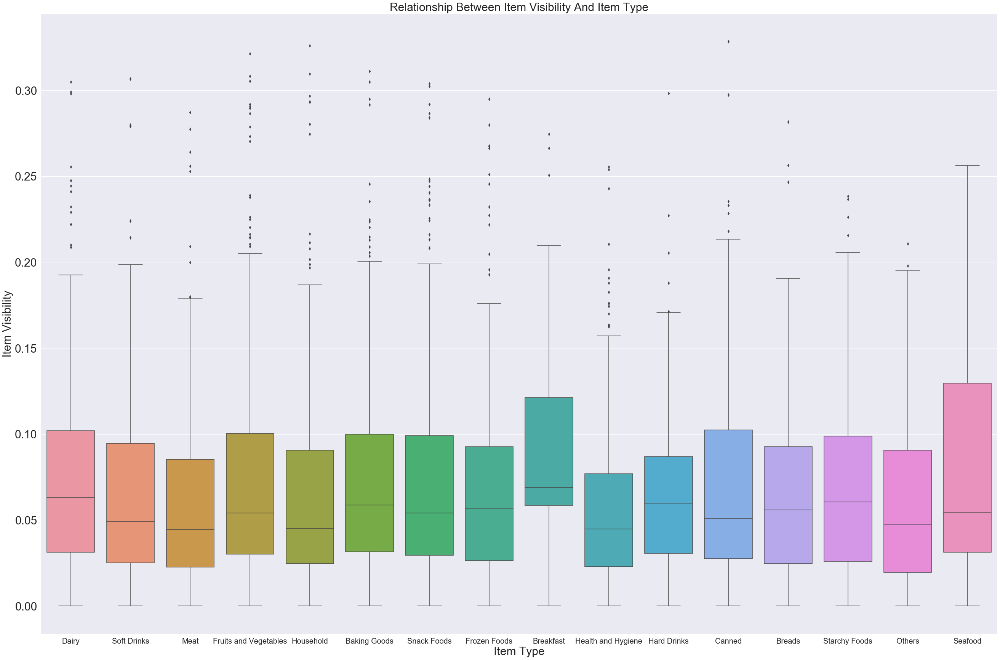

In [23]:
plt.figure(figsize=(45,30))
sns.set(style='darkgrid')
sns.boxplot(x='Item_Type', y='Item_Visibility', data=big_mart)
plt.title('Relationship Between Item Visibility And Item Type', fontsize=30)
plt.xlabel('Item Type', fontsize=30)
plt.ylabel('Item Visibility', fontsize=30)
plt.xticks(size=20)
plt.yticks(size=30) 
plt.show()

### Based on the median, Breakfast Items have a higher visibility and Meat Items have a lower visibility. Based on the size of the boxes, Seafood items have a higher variability in visibility and Hard Drinks have a lower variability in visibility. Seafood items are also further from the visibility median compared to other items. Health and Hygiene items and Hard Drinks items are closer to the visibility median compared to other items.

### b. Check the relationship between Item_Type and Item Fat Content

In [24]:
total = big_mart.groupby(['Item_Type', 'Item_Fat_Content']).count()

In [25]:
total = total.add_suffix('_Count')

In [26]:
total.drop(columns=total.iloc[:,1:], inplace=True)

In [27]:
total.rename(columns={'Item_Identifier_Count':'Count'}, inplace=True)

In [28]:
total.reset_index(inplace=True)

In [29]:
low_fat = big_mart[big_mart.Item_Fat_Content == 'Low Fat'].groupby(['Item_Type', 'Item_Fat_Content']).count() 

In [30]:
low_fat.drop(columns=low_fat.iloc[:,1:], inplace=True)

In [31]:
low_fat.reset_index(inplace=True)

In [32]:
low_fat.rename(columns={'Item_Identifier':'Count'}, inplace=True)

In [33]:
low_fat

,Item_Type,Item_Fat_Content,Count
0,Baking Goods,Low Fat,28
1,Breads,Low Fat,14
2,Breakfast,Low Fat,2
3,Canned,Low Fat,27
4,Dairy,Low Fat,36
5,Frozen Foods,Low Fat,26
6,Fruits and Vegetables,Low Fat,50
7,Hard Drinks,Low Fat,15
8,Health and Hygiene,Low Fat,39
9,Household,Low Fat,70


In [34]:
regular_fat = big_mart[big_mart.Item_Fat_Content == 'Regular'].groupby(['Item_Type', 'Item_Fat_Content']).count() 

In [35]:
regular_fat.drop(columns=regular_fat.iloc[:,1:], inplace=True)

In [36]:
regular_fat.reset_index(inplace=True)

In [37]:
regular_fat.rename(columns={'Item_Identifier':'Count'}, inplace=True)

In [38]:
regular_fat

,Item_Type,Item_Fat_Content,Count
0,Baking Goods,Regular,13
1,Breads,Regular,3
2,Breakfast,Regular,2
3,Canned,Regular,11
4,Dairy,Regular,6
5,Frozen Foods,Regular,19
6,Fruits and Vegetables,Regular,25
7,Meat,Regular,7
8,Snack Foods,Regular,23
9,Soft Drinks,Regular,1


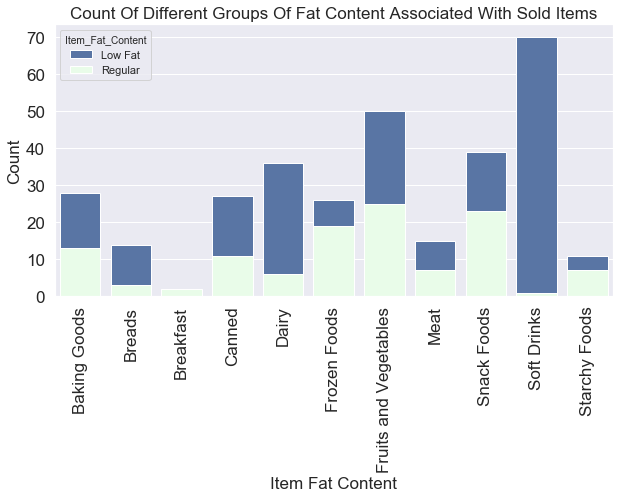

In [39]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.barplot(data=low_fat, x='Item_Type', y='Count', hue='Item_Fat_Content')
sns.barplot(data=regular_fat, x='Item_Type', y='Count', hue='Item_Fat_Content', color='green')
plt.title('Count Of Different Groups Of Fat Content Associated With Sold Items', fontsize=17)
plt.xlabel('Item Fat Content', fontsize=17)
plt.ylabel('Count', fontsize=17)
plt.xticks(size=17, rotation=90)
plt.yticks(size=17) 
plt.show()

### Soft Drinks have the largest number of low fat content products in stock. Fruits and Vegetables have the largest number of regular fat content products. Soft Drinks have the lowest number of Regular Fat content products while Starchy Foods have the lowest number of low fat content products. Soft Drinks have the largest variability when it comes to Regular:Low_Fat Ratio while Baking Goods and Fruits and Vegetables seem to have little to no variability when it comes to Regular:Low_Fat Ratio.

### c. Figure the relationship between Item Type and Item Weight

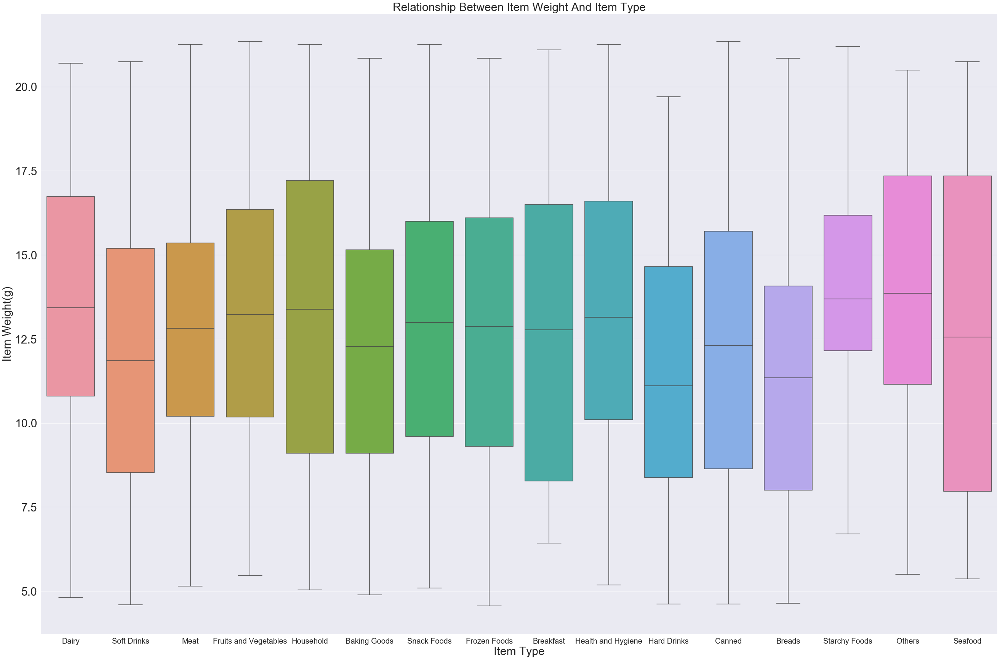

In [40]:
plt.figure(figsize=(45,30))
sns.set(style='darkgrid')
sns.boxplot(x='Item_Type', y='Item_Weight', data=big_mart)
plt.title('Relationship Between Item Weight And Item Type', fontsize=30)
plt.xlabel('Item Type', fontsize=30)
plt.ylabel('Item Weight(g)', fontsize=30)
plt.xticks(size=20)
plt.yticks(size=30) 
plt.show()

### Based on the median, Other items seem to have more weight followed by Dairy items. Hard Drinks have the least weight. Based on the size of the box, Seafood seems to have the largest variability in weight while Starchy foods seem to have the least variability. Other items seem to be closer to the median while bread seems to be far away from the median compared to other items. 

### d. Check the relationship between Item Sales and Item Type

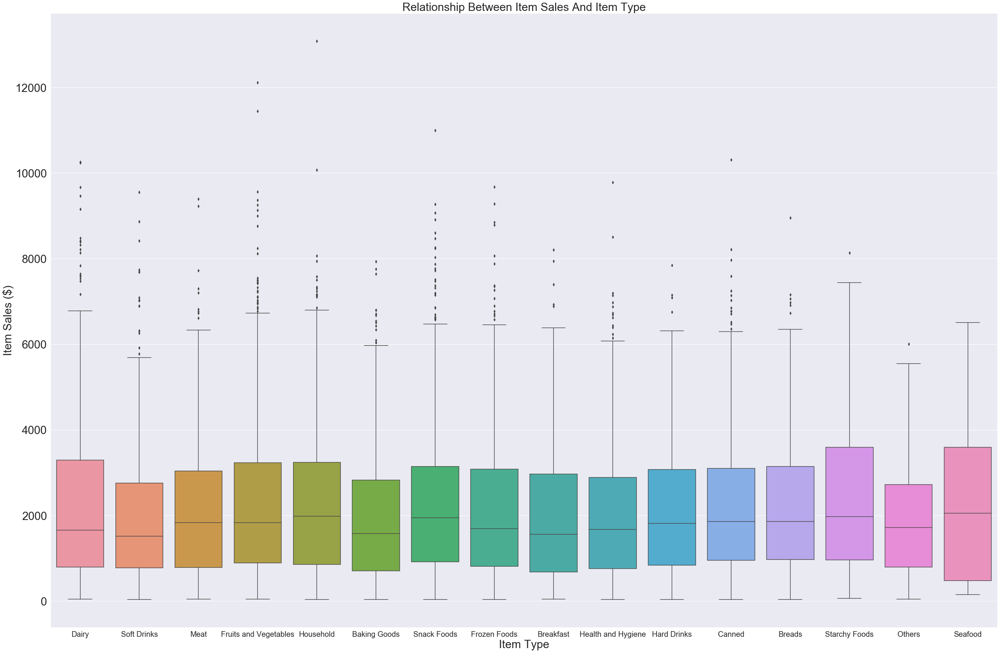

In [41]:
plt.figure(figsize=(45,30))
sns.set(style='darkgrid')
sns.boxplot(x='Item_Type', y='Item_Outlet_Sales', data=big_mart)
plt.title('Relationship Between Item Sales And Item Type', fontsize=30)
plt.xlabel('Item Type', fontsize=30)
plt.ylabel('Item Sales ($)', fontsize=30)
plt.xticks(size=20)
plt.yticks(size=30) 
plt.show()

### Based on the median, Household Items seem to have the highest sales, while Soft Drinks seem to have the lowest sales. Based on the size of the box, Seafood seems to have the largest variability in Sales while Soft Drinks and Other Foods seem to have the lowest variability. Other foods seem to be closer to the median.

### e. Check the relationship between Item Type and Item MRP

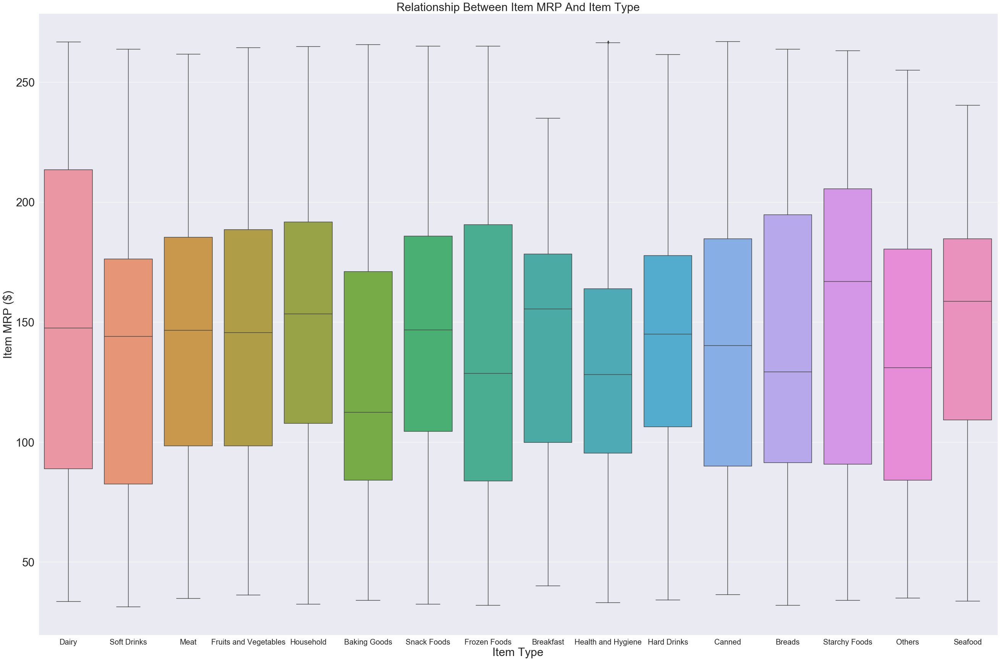

In [42]:
plt.figure(figsize=(45,30))
sns.set(style='darkgrid')
sns.boxplot(x='Item_Type', y='Item_MRP', data=big_mart)
plt.title('Relationship Between Item MRP And Item Type', fontsize=30)
plt.xlabel('Item Type', fontsize=30)
plt.ylabel('Item MRP ($)', fontsize=30)
plt.xticks(size=20)
plt.yticks(size=30) 
plt.show()

### Based on the median, Starchy Foods have the highest MRP while Baking Goods have the lowest MRP. Based on the size of the box, Dairy foods and Starchy Foods have the highest variability while Health and Hygiene items and Hard Drinks have the lowest variability. Baking goods seem to be furthest away from the median compared to other items. 

### f. Compare the relationship between sales and the size of an outlet. 

In [43]:
grouped_sizes = big_mart.groupby('Outlet_Size')['Item_Outlet_Sales'].agg(['sum']).reset_index()

In [44]:
grouped_sizes

,Outlet_Size,sum
0,High,2.142664e+06
1,Medium,7.678059e+06
2,Small,8.770403e+06


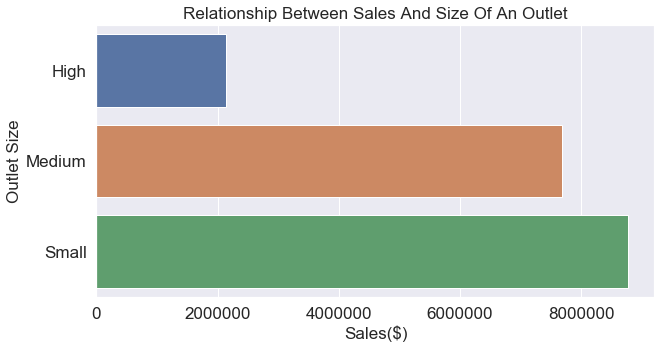

In [45]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.barplot(data=grouped_sizes, x='sum', y='Outlet_Size')
plt.title('Relationship Between Sales And Size Of An Outlet', fontsize=17)
plt.xlabel('Sales($)', fontsize=17)
plt.ylabel('Outlet Size', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.show()

### Small Outlets have higher sales while High Outlets have low sales compared to the other 2 outlets. 

## Correlation

### Check the correlation between the variables in the dataset.

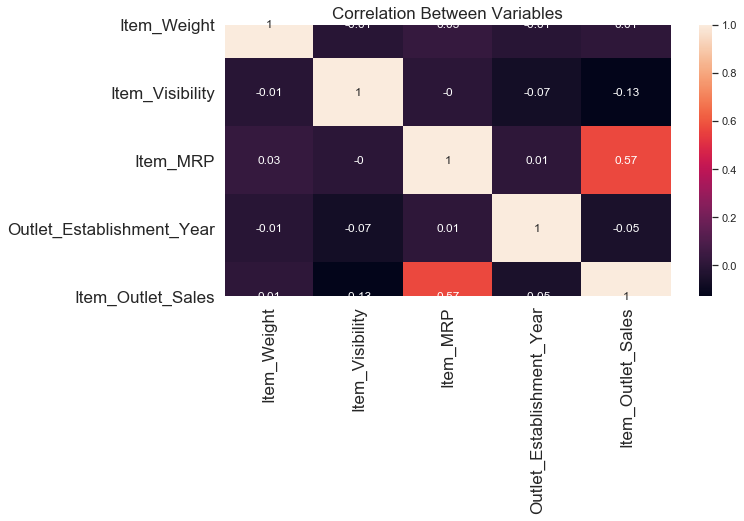

In [46]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.heatmap(np.round(big_mart.corr(), 2), annot=True)
plt.title('Correlation Between Variables', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.show()

### Item Sales and Item MRP are strongly correlated. Item Weight has a really low(almost 0) correlation with the other variables. Item Visibility and Item MRP have a 0 correlation. Item MRP and Outlet Establishment Year have a really low(close to 0) correlation. The 0 and almost close to 0 correlation might in actual fact mean that there is a high non-linear relationship between the two variables.  

## Other Analysis

### Examine the establishment of different big mart outlets throughout the years

In [47]:
outlet_years = big_mart.groupby('Outlet_Establishment_Year')['Outlet_Type'].count().reset_index()

In [48]:
outlet_years

,Outlet_Establishment_Year,Outlet_Type
0,1985,1463
1,1987,932
2,1997,930
3,1998,555
4,1999,930
5,2002,929
6,2004,930
7,2007,926
8,2009,928


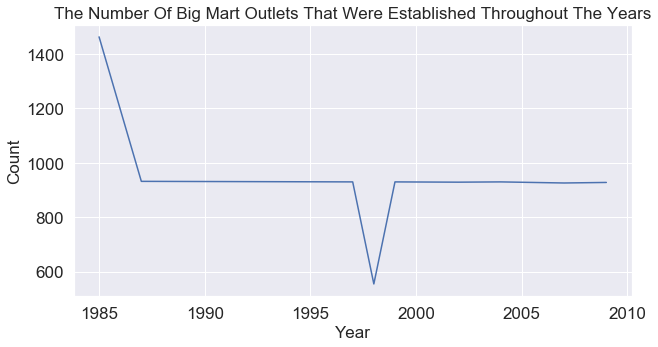

In [49]:
plt.figure(figsize=(10,5))
sns.set(style='darkgrid')
sns.lineplot(data=outlet_years, x='Outlet_Establishment_Year', y='Outlet_Type')
plt.title('The Number Of Big Mart Outlets That Were Established Throughout The Years', fontsize=17)
plt.xlabel('Year', fontsize=17)
plt.ylabel('Count', fontsize=17)
plt.xticks(size=17)
plt.yticks(size=17) 
plt.show()

### Most of the Big Mart Outlets were established right at the beginning in 1985. The number started to decrease and reached a minimum of less than 500 outlets in about 1998. After 1998, the establishments started to increase again and they reached a constant of about 900 outlets per year up until 2009.